In [13]:
import pandas as pd
from category_encoders import TargetEncoder

In [14]:
# load cleaned datasets
train_df = pd.read_csv('C:\\Users\\Mustapha\\Desktop\\ML-Project-Scratch\\data\\processed\\cleaning_train.csv')
eval_df = pd.read_csv('C:\\Users\\Mustapha\\Desktop\\ML-Project-Scratch\\data\\processed\\cleaning_eval.csv')
holdout_df = pd.read_csv('C:\\Users\\Mustapha\\Desktop\\ML-Project-Scratch\\data\\processed\\cleaning_holdout.csv')

pd.set_option('display.max_columns', None)  # Show all columns when displaying DataFrames
pd.set_option('display.max_rows', None)     # Show all rows when displaying DataFrames

print("train date range:", train_df['date'].min(), "to", train_df['date'].max())
print("eval date range:", eval_df['date'].min(), "to", eval_df['date'].max())
print("holdout date range:", holdout_df['date'].min(), "to", holdout_df['date'].max())

# Check datetime format
train_df['date'] = pd.to_datetime(train_df['date'])
eval_df['date'] = pd.to_datetime(eval_df['date'])
holdout_df['date'] = pd.to_datetime(holdout_df['date'])

train date range: 2012-03-31 to 2019-12-31
eval date range: 2020-01-31 to 2021-12-31
holdout date range: 2022-01-31 to 2023-12-31


In [15]:
train_df.head(2)

,date,median_sale_price,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,city,zipcode,year,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,city_full,lat,lng
0,2012-03-31,46550.0,217450.0,31.813674,110.183666,14.0,23.0,44.0,64.0,59.5,0.943662,0.142857,0.043478,ATL,30002,2012,12.0,2.0,4.0,1.0,60.0,45.0,57.0,4.0,7.0,5811.0,36.3,33052.0,5811.0,2677.0,710.0,279500.0,3171.0,460.0,5408.0,5408.0,2492.0,200773.999557,Atlanta-Sandy Springs-Roswell,33.7338,-84.3922
1,2012-03-31,234650.0,265000.0,130.620985,154.023973,81.0,101.0,149.0,174.0,95.0,0.933685,0.086420,0.148515,DAL,76107,2012,0.0,0.0,7.0,0.0,50.0,2.0,96.0,1.0,3.0,25530.0,35.9,40406.0,25143.0,13685.0,782.0,179700.0,14117.0,988.0,24264.0,24264.0,12291.0,158643.875925,Dallas-Fort Worth-Arlington,32.8495,-96.9704


In [16]:
# date feature engineering

def add_date_features(df):
    df['year'] = df['date'].dt.year
    df['quarter'] = df['date'].dt.quarter
    df['month'] = df['date'].dt.month

    # Reorder columns
    df.insert(1, "year", df.pop("year"))
    df.insert(2, "quarter", df.pop("quarter"))
    df.insert(3, "month", df.pop("month"))
    return df

train_df = add_date_features(train_df)
eval_df = add_date_features(eval_df)
holdout_df = add_date_features(holdout_df)

In [17]:
print(train_df.shape)
train_df.head(1)

(576815, 43)


,date,year,quarter,month,median_sale_price,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,city,zipcode,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,city_full,lat,lng
0,2012-03-31,2012,1,3,46550.0,217450.0,31.813674,110.183666,14.0,23.0,44.0,64.0,59.5,0.943662,0.142857,0.043478,ATL,30002,12.0,2.0,4.0,1.0,60.0,45.0,57.0,4.0,7.0,5811.0,36.3,33052.0,5811.0,2677.0,710.0,279500.0,3171.0,460.0,5408.0,5408.0,2492.0,200773.999557,Atlanta-Sandy Springs-Roswell,33.7338,-84.3922


In [18]:
print(eval_df.shape)
eval_df.head(1)

(148448, 43)


,date,year,quarter,month,median_sale_price,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,city,zipcode,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,city_full,lat,lng
0,2020-01-31,2020,1,1,268000.0,275900.0,117.649979,121.116709,105.0,98.0,87.0,75.0,41.5,0.984043,0.152381,0.459184,CIN,45066,10.0,0.0,1.0,0.0,14.0,16.0,11.0,0.0,3.0,25040.0,38.4,45191.0,24856.0,9042.0,1172.0,240000.0,13025.0,331.0,23976.0,23976.0,11917.0,288036.180506,Cincinnati,39.0811,-84.4646


In [19]:
print(holdout_df.shape)
holdout_df.head(1)

(148943, 43)


,date,year,quarter,month,median_sale_price,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,city,zipcode,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,city_full,lat,lng
0,2022-01-31,2022,1,1,375000.0,300000.0,234.700521,238.066826,23.0,25.0,21.0,10.0,31.0,1.019467,0.608696,0.0,NY,7850,7.0,0.0,0.0,1.0,10.0,27.0,20.0,3.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,388344.519628,New York-Newark-Jersey City,40.7222,-74.0225


In [28]:
# ============================
# 3. Frequency Encoding (zipcode)
# ============================
zip_counts = train_df["zipcode"].value_counts()

train_df["zipcode_freq"] = train_df["zipcode"].map(zip_counts)
eval_df["zipcode_freq"] = eval_df["zipcode"].map(zip_counts).fillna(0)
holdout_df["zipcode_freq"] = holdout_df["zipcode"].map(zip_counts).fillna(0)

print("Zip freq example (train):")
print(train_df[["zipcode", "zipcode_freq"]])


'''
🔍 Nuance:

- On train, we build the frequency dictionary (zip_counts).
- On eval, we never compute new counts → we only look up in the dictionary.
- If eval has an unseen zipcode, it gets NaN, which we replace with 0.
'''

Zip freq example (train):
        zipcode  zipcode_freq
0         30002            94
1         76107            94
2         76088            94
3         75150            94
4         48221            94
5         28205            94
6         80021            94
7         80022            94
8         20815            94
9         80019            94
10        90670            94
11        76086            94
12        80020            94
13        76106            94
14        76087            94
15        76092            94
16        75149            94
17        76093            94
18        76102            94
19        76103            94
20        76104            94
21        75146            94
22        80017            94
23        80015            94
24        28173            94
25        76064            94
26        28206            94
27        80113            94
28        80116            94
29        80117            94
30        80031            94
31        8003

'\n🔍 Nuance:\n\n- On train, we build the frequency dictionary (zip_counts).\n- On eval, we never compute new counts → we only look up in the dictionary.\n- If eval has an unseen zipcode, it gets NaN, which we replace with 0.\n'

In [32]:
# ============================
# 4. Target Encoding (city_full)
# ============================
te = TargetEncoder(cols=["city_full"])

train_df["city_encoded"] = te.fit_transform(train_df["city_full"], train_df["price"])
eval_df["city_encoded"] = te.transform(eval_df["city_full"])
holdout_df["city_encoded"] = te.transform(holdout_df["city_full"])

print("City encoding example (train):")
print(train_df[["city_full", "city_encoded"]].head())

'''
🔍 Nuance:

- On train, we call fit_transform() → this computes the mapping from city → avg price using training targets.
- On eval, we only call transform() → it applies the train mapping. It never looks at eval’s price column.
'''

City encoding example (train):
                       city_full   city_encoded
0  Atlanta-Sandy Springs-Roswell  192627.058387
1    Dallas-Fort Worth-Arlington  209105.973386
2    Dallas-Fort Worth-Arlington  209105.973386
3    Dallas-Fort Worth-Arlington  209105.973386
4        Detroit-Warren-Dearborn  166892.458193


'\n🔍 Nuance:\n\n- On train, we call fit_transform() → this computes the mapping from city → avg price using training targets.\n- On eval, we only call transform() → it applies the train mapping. It never looks at eval’s price column.\n'

In [33]:
# ============================
# 5. Drop unused columns
# ============================
# Drop leakage column "median_sale_price"
drop_cols = ["date", "city_full", "city", "zipcode", "median_sale_price"]
train_df.drop(columns=drop_cols, inplace=True)
eval_df.drop(columns=drop_cols, inplace=True)
holdout_df.drop(columns=drop_cols, inplace=True)

In [34]:
print(train_df.shape)
train_df.head(1)

(576815, 40)


,year,quarter,month,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,lat,lng,zipcode_freq,city_encoded
0,2012,1,3,217450.0,31.813674,110.183666,14.0,23.0,44.0,64.0,59.5,0.943662,0.142857,0.043478,12.0,2.0,4.0,1.0,60.0,45.0,57.0,4.0,7.0,5811.0,36.3,33052.0,5811.0,2677.0,710.0,279500.0,3171.0,460.0,5408.0,5408.0,2492.0,200773.999557,33.7338,-84.3922,94,192627.058387


In [35]:
print(eval_df.shape)
eval_df.head(1)

(148448, 40)


,year,quarter,month,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,lat,lng,zipcode_freq,city_encoded
0,2020,1,1,275900.0,117.649979,121.116709,105.0,98.0,87.0,75.0,41.5,0.984043,0.152381,0.459184,10.0,0.0,1.0,0.0,14.0,16.0,11.0,0.0,3.0,25040.0,38.4,45191.0,24856.0,9042.0,1172.0,240000.0,13025.0,331.0,23976.0,23976.0,11917.0,288036.180506,39.0811,-84.4646,94.0,150644.162953


In [36]:
# save feature engineered datasets
train_df.to_csv('C:\\Users\\Mustapha\\Desktop\\ML-Project-Scratch\\data\\processed\\feature_engineered_train.csv', index=False)
eval_df.to_csv('C:\\Users\\Mustapha\\Desktop\\ML-Project-Scratch\\data\\processed\\feature_engineered_eval.csv', index=False)
holdout_df.to_csv('C:\\Users\\Mustapha\\Desktop\\ML-Project-Scratch\\data\\processed\\feature_engineered_holdout.csv', index=False)

print("✅ Feature engineered datasets saved successfully!")
print("train shape:", train_df.shape)
print("eval shape:", eval_df.shape)
print("holdout shape:", holdout_df.shape)

✅ Feature engineered datasets saved successfully!
train shape: (576815, 40)
eval shape: (148448, 40)
holdout shape: (148943, 40)


- Fit frequency encoding on train only, apply to eval (with fillna(0) in case eval has unseen zipcodes).

- Fit target encoding on train only, apply to eval with the same mapping.

- Added a helper add_date_features so date feature logic isn’t duplicated.

- Dropped unused columns consistently from both datasets 

- Droped high correlated column "median_sale_price"

- Saved three separate outputs

✅ So the nuance is:

- Train → fit transformations (learn rules from the past).

- Eval → transform with those rules (apply them to future data).

- Never re-fit on eval. That’s what keeps eval “unseen” and leakage-free.

## Multicolinearity

to look at multicolinearity we can use:
- VIF
- Correlation matrix

In [38]:
df = train_df 

from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

def calculate_vif(df, target_col=None):
    """
    Calculate Variance Inflation Factor (VIF) for each numeric column in df.
    """
    # Keep only numeric columns
    numeric_df = df.select_dtypes(include=['float64', 'int64']).copy()

    # Drop target if provided
    if target_col and target_col in numeric_df.columns:
        numeric_df = numeric_df.drop(columns=[target_col])

    # Add constant for statsmodels
    X = add_constant(numeric_df)

    # Compute VIF (skip the first column = constant)
    vif_data = pd.DataFrame()
    vif_data["feature"] = numeric_df.columns
    vif_data["VIF"] = [
        variance_inflation_factor(X.values, i + 1)  # skip constant at index 0
        for i in range(len(numeric_df.columns))
    ]

    return vif_data.sort_values("VIF", ascending=False).reset_index(drop=True)


# Look at VIF and correlation with original training dataset
df = pd.read_csv("C:\\Users\\Mustapha\\Desktop\\ML-Project-Scratch\\data\\raw\\train.csv")
vif_table = calculate_vif(df, target_col="price")
print(vif_table)


c:\Users\Mustapha\Desktop\ML-Project-Scratch\.venv\Lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


                         feature          VIF
0        Total School Enrollment          inf
1    Total School Age Population          inf
2               Total Population  6600.440350
3              Total Labor Force   839.557009
4            Median Commute Time   650.528668
5   Total Families Below Poverty   573.705680
6            Total Housing Units    21.298479
7                   new_listings    19.930888
8                     homes_sold    13.409262
9          Unemployed Population    12.881559
10                    restaurant    10.915101
11                          bank    10.680631
12                   supermarket     9.630326
13                 pending_sales     9.241440
14             Median Home Value     6.826955
15                     inventory     5.887100
16                          park     5.676253
17                        school     5.657422
18                       station     4.654858
19             Per Capita Income     4.619926
20                   Median Rent  

How to interpret

- IF > 10 → serious multicollinearity.

- VIF > 100 → catastrophic (drop/re-engineer immediately).

- VIF = ∞ → perfect linear redundancy (drop one).

In [39]:
offenders = ["Total Population", "Total Labor Force", "Total Families Below Poverty"]
corr_matrix = df[offenders].corr()
corr_matrix

,Total Population,Total Labor Force,Total Families Below Poverty
Total Population,1.000000,0.985715,0.998992
Total Labor Force,0.985715,1.000000,0.985703
Total Families Below Poverty,0.998992,0.985703,1.000000


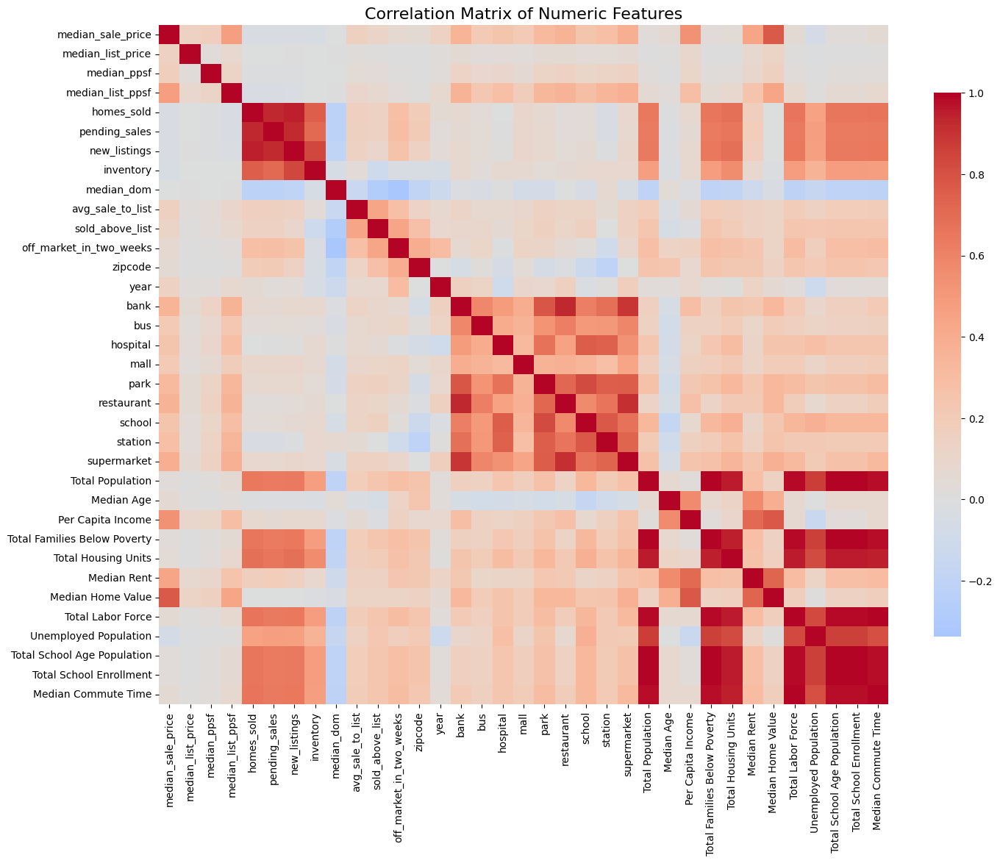

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select only numeric features (exclude the target 'price')
numeric_df = df.select_dtypes(include=['float64', 'int64']).drop(columns=["price"], errors="ignore")

# Compute correlation matrix
corr_matrix = numeric_df.corr()

# Display full matrix as heatmap
plt.figure(figsize=(16,12))
sns.heatmap(
    corr_matrix, 
    cmap="coolwarm", 
    center=0, 
    annot=False,   # set to True if you want numbers on cells
    cbar_kws={"shrink": 0.8}
)
plt.title("Correlation Matrix of Numeric Features", fontsize=16)
plt.show()

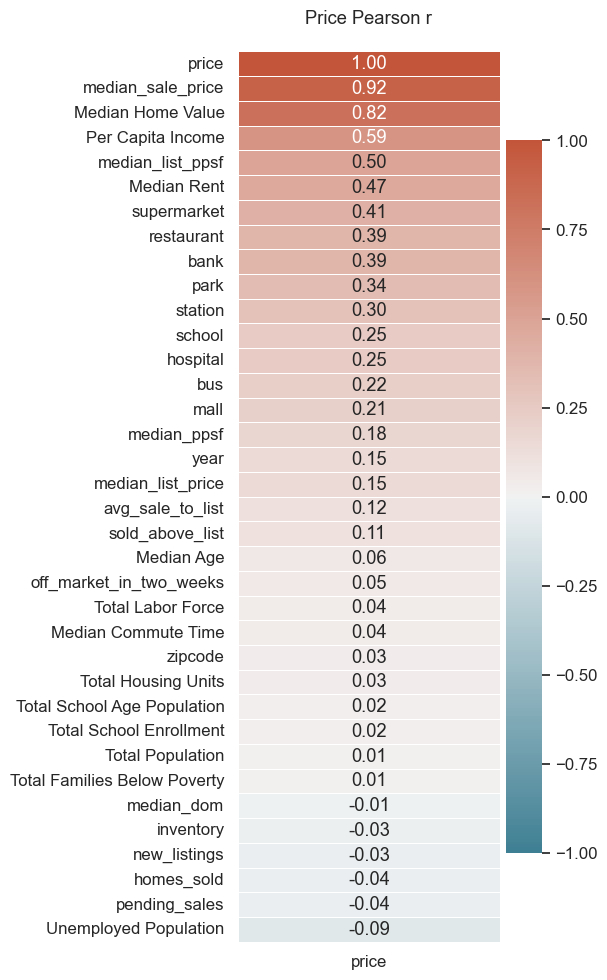

In [41]:
# Compute correlations with price
num_cols = df.select_dtypes("number").columns
corr_vec  = df[num_cols].corr(method="pearson")["price"].sort_values(ascending=False)
sns.set_theme(style="white")     
sns.set(font_scale=1.1)          
plt.figure(figsize=(6,10))       
ax = sns.heatmap(
        corr_vec.to_frame(),     
        annot=True, fmt=".2f",
        vmin=-1, vmax=1,         
        cmap=sns.diverging_palette(220, 20, as_cmap=True),
        center=0,
        linewidths=.5, linecolor="white",
        cbar_kws={"shrink":0.8, "pad":0.02}
     )
ax.set_title("Price Pearson r", pad=20)
ax.set_ylabel("")                 
ax.set_xlabel("")
plt.tight_layout()
plt.show()